# Overall Goals
- **Explore different reprsentations and features of my data**
- **Design classifier baselines off of video data, and a bag of features (clip embedding) for linear probing**
- **Refine video framing pipeline for downstream alt-right symbol identification task**
- **This is all with the intention of A: building out a dataset of alt right core core symbols, and B: seeing if that data can disentangle "normal corecore" from alt right.**

# Section 1: Introducing and Exploring my Data
### At a glance
- My dataset is derived from TikTok, wherein I indexed a large set of videos pertaining to specific tags and genre formats on TikTok
- The dataset is comprised of 950 "alt-right" TikToks, and 579 "normal" TikToks, totaling to about 1531 videos
- In addition, I attempted to scrape around ~20 comments from each video, **for a total of 22135 comments**
- There is "noise" in the dataset. That is, although a majority of the videos I indexed are either exactly a corecore edit or have to do with an alt-right topic, my indexing technique also pulled some seemingly random/non-related videos

### Indexing Technique Explained
- The following videos were iteratively indexed from TikTok, while keeping a log of all videos pulled to ensure that no duplicate videos were pulled. This also has the effect of ensuring that our "normal" tiktok/corecore set is disjoint from our "alt-right" set.
- Alt-right videos were pulled from the following tags: "hyperborea", "Agartha", "vril", "another classic". Each of these tags are emblematic of a specific tag/dogwhistle currently being popularly employed by the alt right, which was determined through a qualitative exploration of different corecore edit tags. I am also considering using audios that are frequently associated with the Alt-Right, such as a remix of "Land down under."
- "Normal" corecore videos were pulled from the tag corecore, as well as hopecore and other popular tags used for mainstream corecore edits

### What this section will explore:
- This section aims to get a sense for the data, discovering aspects such as: average run time, average scene transition rate (shot boundary detection) and duration
- We will calculate IQR for each set to filter out "noisy" videos
- We will then bootstrap the mean from corecore edits, to test if INSERT ANALYSIS HERE
- The reason I look at these aspects in particular are due to the genre conventions of corecore edits. Corecore edits are comprised of an assemblage of scene changes and transitions, comprised of multimodal data. If it is the recurrent images and symbols that distinguish alt-right corecore from normal corecore, I want to see if these aspects fall within the distribution of expected values for a normal corecore video

### Goals of this section:
- **Filtering out videos which don't match other ones**
- **Split videos into train and test sets to ensure statistical validity in downstream analysis**
- **Understanding the general distribution of mean duration and mean scenetransitionrate for corecore videos, compare to altright mean**

In [48]:
os.environ["TOKENIZERS_PARALLELISM"] = "false"
import glob
import os
import re
import cv2
import scenedetect
from scenedetect import open_video, SceneManager, ContentDetector

In [2]:
# making functions for exploration
def findFilePaths(source_dir):
    """
    get file paths, return both in lists
    """
    # search directory with wildcard regex to locate all files
    files = glob.glob(os.path.join(source_dir, '*'))

    return files

def calculateDuration(paths):
    """
    intake file paths, calculate durations for them, return in 
    (filepath,duration) tuple

    duration in seconds = frame_count/fps
    """
    video_durations = []

    # go to each video
    for file in paths:
        # create video capture for cv2
        vid = cv2.VideoCapture(file)

        # get fps
        fps = vid.get(cv2.CAP_PROP_FPS)

        # get number of frames
        nframes = vid.get(cv2.CAP_PROP_FRAME_COUNT)

        # calc duration
        duration = nframes/fps
        video_durations.append((file, duration))

    return video_durations

def calculateSceneTransitionRate(paths):
    """
    Using PySceneDetect's content detection scheme to uncover
    the scene transition rate. A higher rate means a faster-paced video.
    """

    video_scene_rates = []
    
    # Go through each video path
    for file in paths:
        video = None  # Initialize video to None for the finally block


        # open the video using the new open_video() function
        video = open_video(file)

        # get video duration in seconds from the video object
        duration_sec = video.duration.get_seconds()

        rate_per_sec = 0.0

        # Only process if the video has a valid duration
        if duration_sec > 0:
            # create a SceneManager and add the detector
            scene_manager = SceneManager()
            scene_manager.add_detector(ContentDetector())

            # detect scenes
            scene_manager.detect_scenes(video=video, show_progress=False)

            # get the scene list-
            scene_list = scene_manager.get_scene_list()

            # calculate transitions. 1 scene = 0 transitions.
            num_transitions = len(scene_list) - 1

            # error handling
            if num_transitions > 0:
                rate_per_sec = num_transitions / duration_sec
        
        # append the result for this file
        video_scene_rates.append((file, rate_per_sec))

       # close the video file handle, re open
        if video:
            video.reset()
                
    return video_scene_rates
    

## Filtering noise
- Look at IQR for videos, filter out videos which do not match (maintain list of videos to not pull for later analysis)

In [3]:
import seaborn as sns # for boxplots and IQR work
import numpy as np # for iqr outlier detection
import io
import base64
from PIL import Image
from IPython.display import display, HTML
import matplotlib.pyplot as plt

In [4]:
def findOutliers(data_tuples):
    """
    identify outliers from a list of (name, value) tuples using IQR
    IQR defines an outlier as any value that falls outside the range: [Q1 - 1.5 * IQR, Q3 + 1.5 * IQR].

    returns a list of video names corresponding to the outlier values.
    """
    # extract just the values
    values = [item[1] for item in data_tuples]

    # calculate Q1, Q3, and IQR
    
    # Q1 is the 25th percentile
    q1 = np.percentile(values, 25)
    
    # Q3 is the 75th percentile
    q3 = np.percentile(values, 75)
    
    iqr = q3 - q1

    # define the outlier bounds
    lower_bound = q1 - (1.5 * iqr)
    upper_bound = q3 + (1.5 * iqr)

    # ientify outliers and collect their names
    outlier_names = []
    for name, value in data_tuples:
        if value < lower_bound or value > upper_bound:
            outlier_names.append(name)

    return outlier_names

def frame_to_base64(frame):
    """converts OpenCV frame to a Base64 string."""
    # Convert BGR (OpenCV default) to RGB (PIL/web default)
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    
    # Create PIL image from array
    img = Image.fromarray(frame_rgb)
    
    # Create in-memory buffer
    buffer = io.BytesIO()
    
    # Save image to buffer as JPEG
    img.save(buffer, format="JPEG")
    
    # Get byte data and encode to base64
    b64_str = base64.b64encode(buffer.getvalue()).decode("utf-8")
    
    return b64_str
def displayOutliers(paths):
    """
    take list of video paths and displays three frames
    (10%, 50%, 90%) for each video 
    
    """
    
    # start building the final HTML string (to display frames)
    html_output = ""
    
    print(f"Processing {len(paths)} video(s)...")

    for path in paths:
        if not os.path.exists(path):
            html_output += f'<h3>{os.path.basename(path)}</h3>'
            html_output += f'<p style="color: red;">Error: File not found.</p>'
            continue

        cap = None
        try:
            cap = cv2.VideoCapture(path)
            if not cap.isOpened():
                html_output += f'<h3>{os.path.basename(path)}</h3>'
                html_output += f'<p style="color: red;">Error: Could not open video file.</p>'
                continue

            # get video properties
            total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
            
            # define representative frame positions
            frame_positions = [
                int(total_frames * 0.10),
                int(total_frames * 0.50),
                int(total_frames * 0.90)
            ]
            
            # handle very short videos
            if total_frames < 3:
                frame_positions = [0]
            
            base64_frames = []
            
            # extract each frame
            for pos in frame_positions:
                cap.set(cv2.CAP_PROP_POS_FRAMES, pos)
                ret, frame = cap.read()
                if ret:
                    b64_str = frame_to_base64(frame)
                    if b64_str:
                        base64_frames.append(b64_str)
                else:
                    print(f"Warning: Could not read frame at position {pos} from {path}")

            # build the HTML for this video
            
            # add the title (smaller font, less margin)
            html_output += f'<h3 style="font-size: 1.1em; margin-bottom: 3px; margin-top: 10px;">{os.path.basename(path)}</h3>'
            
            # create a flex container (tighter padding/margins)
            html_output += '<div style="display: flex; justify-content: flex-start; margin-bottom: 10px; padding: 5px; background: #f9f9f9; border: 1px solid #eee; border-radius: 8px;">'
            
            if not base64_frames:
                 html_output += '<p>Could not extract any frames.</p>'
            
            # add each image (fixed 150px width)
            for b64_str in base64_frames:
                html_output += f"""
                    <img 
                        src="data:image/jpeg;base64,{b64_str}" 
                        style="width: 150px; 
                               height: auto;
                               margin-right: 5px; 
                               border: 1px solid #ccc; 
                               border-radius: 5px; 
                               object-fit: contain;" 
                    />
                """
            
            # close the flex container
            html_output += '</div>'

        except Exception as e:
            html_output += f'<h3>{os.path.basename(path)}</h3>'
            html_output += f'<p style="color: red;">An unexpected error occurred: {e}</p>'
        finally:
            # important: Release the video capture object
            if cap:
                cap.release()

    # display the final rendered HTML all at once
    display(HTML(html_output))


In [5]:
# calculating duration and scene rate for alt-right videos, getting outliers (TAKES SOME TIME TO RUN)
alt_right_vids = findFilePaths("videos/alt_right_2")
alt_right_durations = calculateDuration(alt_right_vids) 

# commenting this out, as the identified outliers for this subset were ok. However, also took a long time to run
# you can uncomment to check if you'd like, just warning on run time
alt_right_scene_rate = calculateSceneTransitionRate(alt_right_vids)

Processing 99 video(s)...



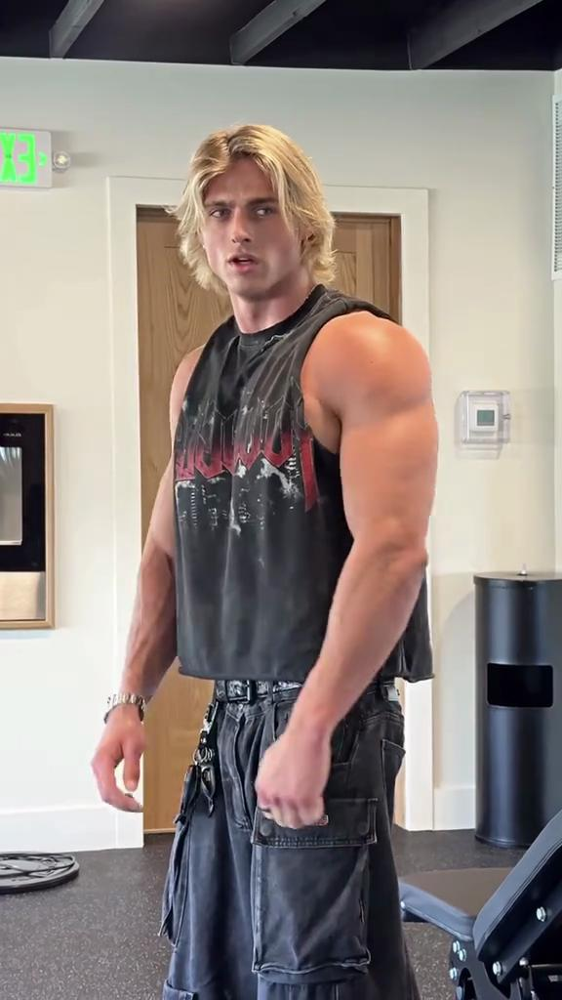
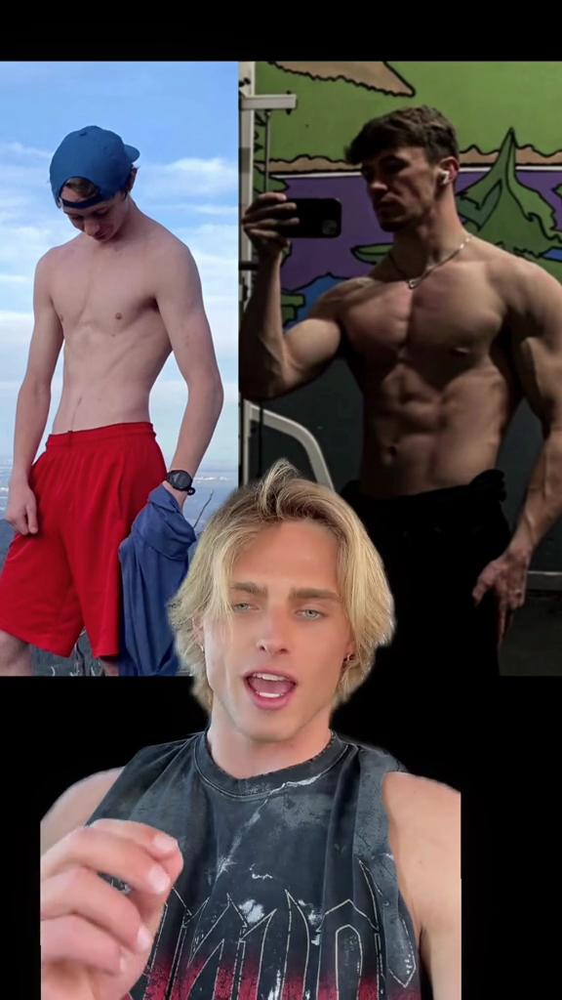
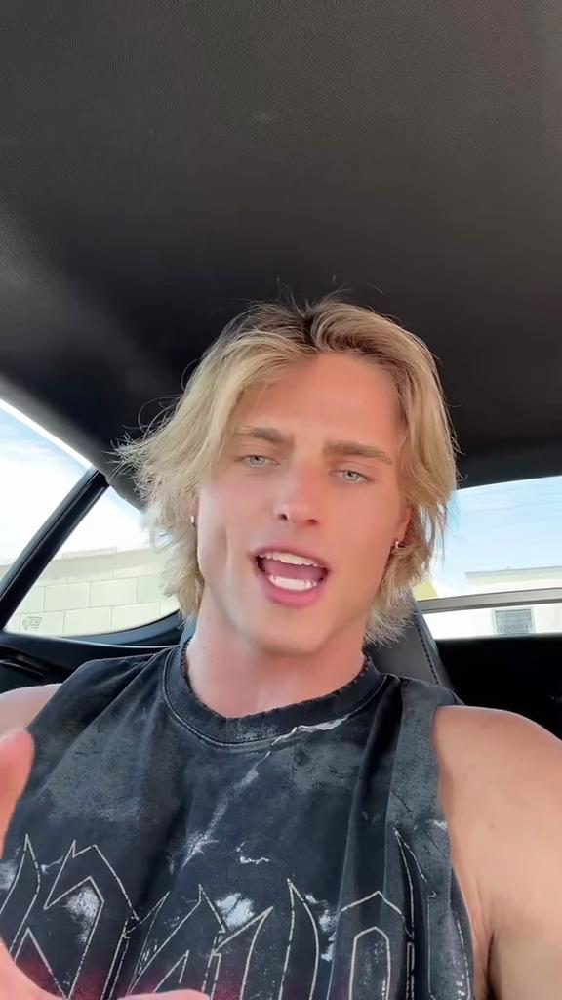
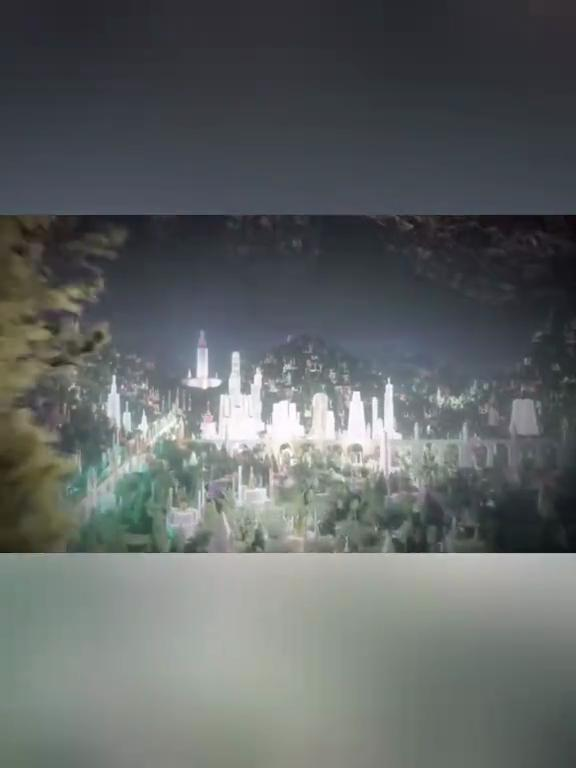
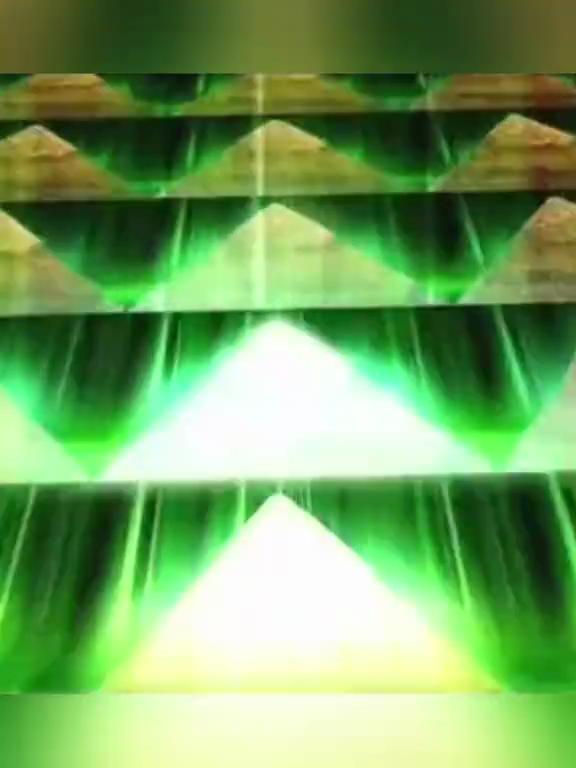
...
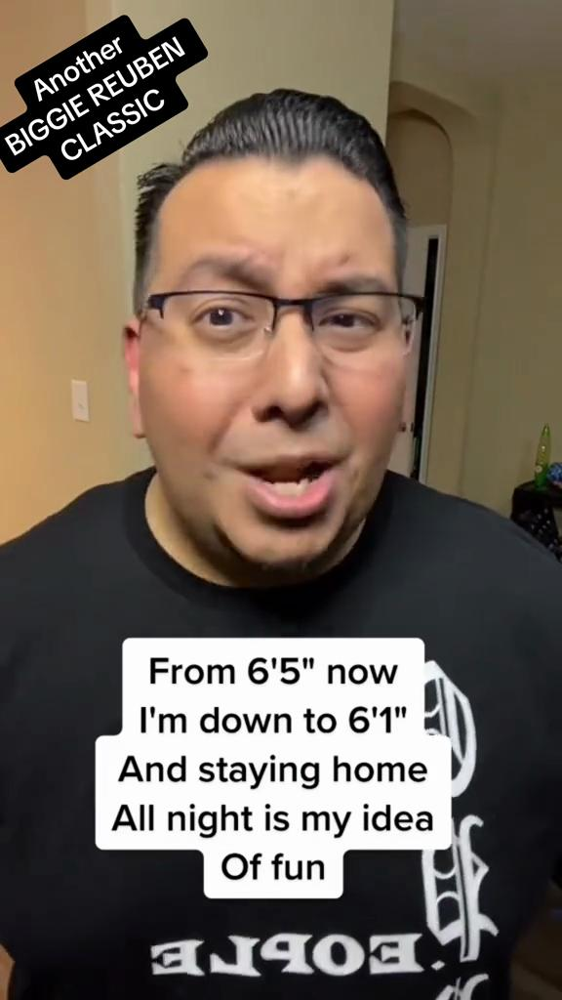
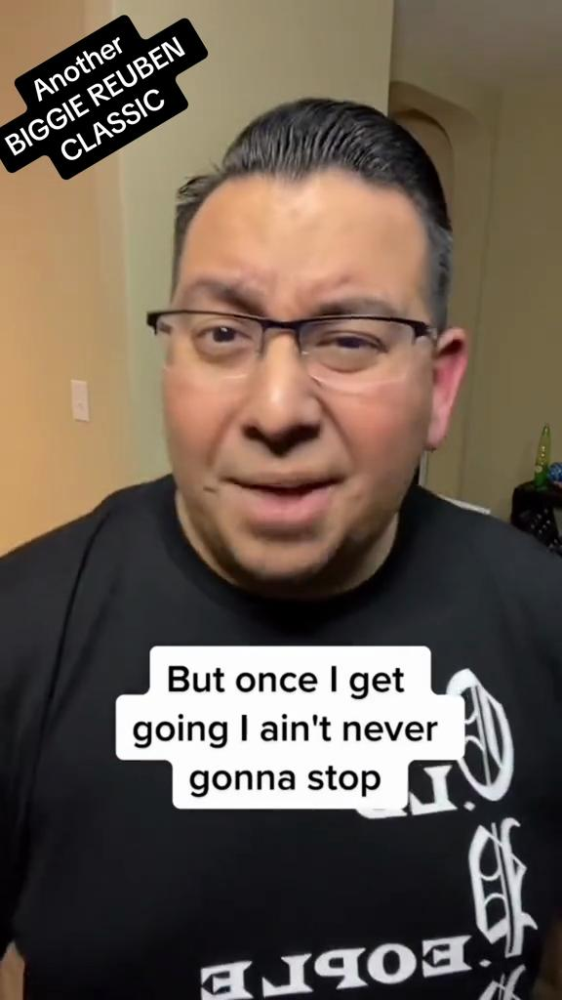
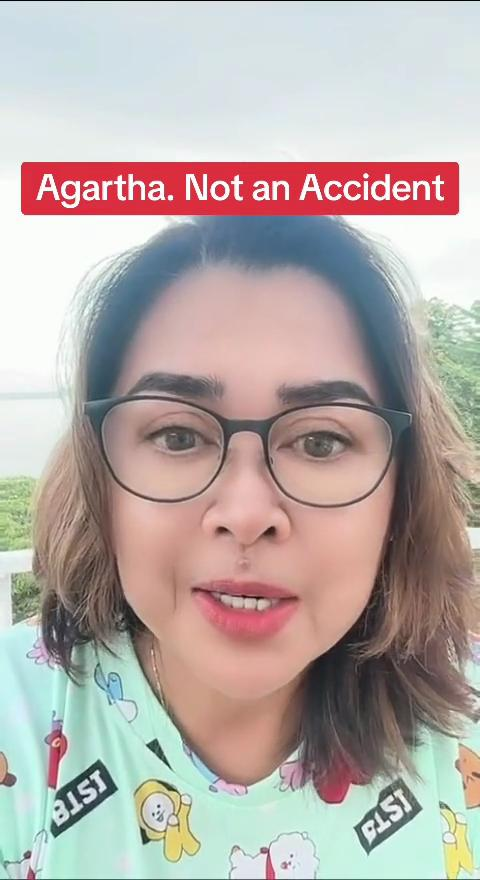
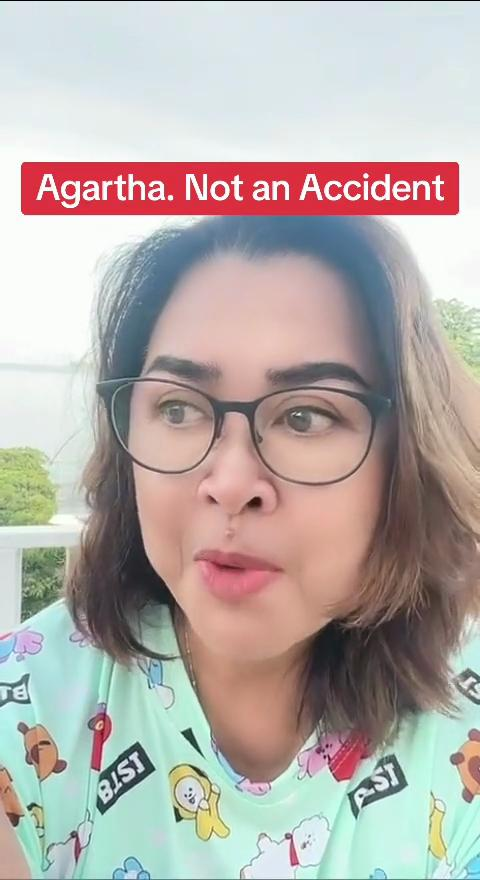
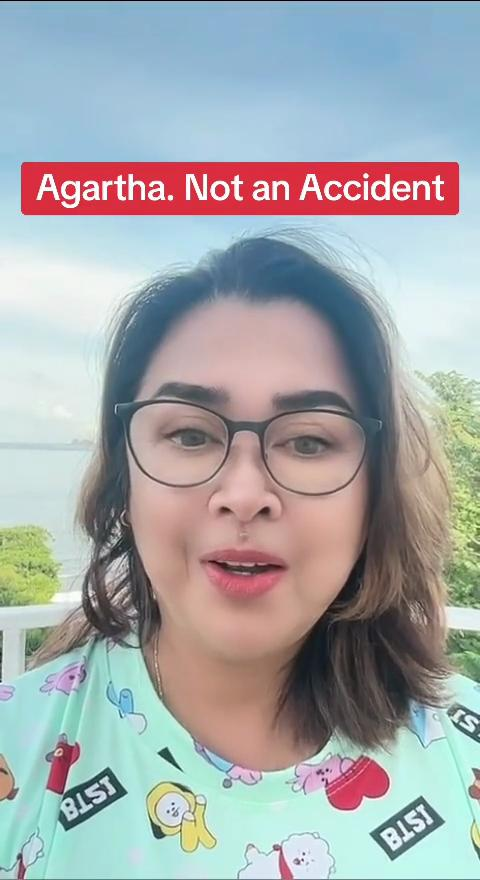

In [6]:
# displayOutliers(findOutliers(alt_right_scene_rate) <- THIS INITIAL CHECK SHOWED ALL VIDEOS AS RELATED TO THE CORECORE FORMAT, IGNORING THESE OUTLEIRS
displayOutliers(findOutliers(alt_right_durations))

In [7]:
# Using results from the above, I went through each video and tried to check its relevance to corecore or the alt right
# It seems that one of my # searches, #anotherclassic, returned many videos about songs and cartoons
ignore_list_alt_right = (
    "vril_hyperborea_combovideo-truthnever-20251023213246-7564533323821894915.mp4",
    "alt_right_superfilevideo-adrealzz-20211007180755-7016387741806103813.mp4",
    "alt_right_superfilevideo-vrilliant-20250813090012-7537992329630895382.mp4",
    "alt_right_superfilevideo-jacqueline-20240215164448-7335870648037690629.mp4",
    "hyperborea_scrapevideo-jb_jstn-20241106171634-7434216370499308801.mp4",
    "alt_right_superfilevideo-weirdismym-20230423160124-7225276076019191066.mp4",
    "alt_right_superfilevideo-pianoplane-20250316153931-7482432463629831446.mp4",
    "alt_right_superfilevideo-agartha280-20250914012020-7549748548292726021.mp4",
    "hyperborea_scrapevideo-doc4heart-20251023175733-7564477829992189214.mp4",
    "alt_right_superfilevideo-kulaniii-20251026220734-7565655378323721485.mp4",
    "hyperborea_scrapevideo-rizkinhk-20240320011203-7348247169075367173.mp4",
    "alt_right_superfilevideo-agartha280-20250813194047-7538157407612980536.mp4",
    "alt_right_superfilevideo-garthchoco-20240529184731-7374495117962399018.mp4",
    "alt_right_superfilevideo-myfinasele-20250323224227-7485139042430946565.mp4",
    "alt_right_superfilevideo-nathanbrow-20220605172011-7105806959701429509.mp4",
    "hyperborea_scrapevideo-d00dl3sm00-20251020100234-7563241703277219127.mp4",
    "alt_right_superfilevideo-thechosenc-20241213212928-7448011721689795886.mp4",
    "alt_right_superfilevideo-vrilliant-20250410083500-7491600182740634902.mp4",
    "vril_hyperborea_combovideo-ayounglee7-20240921152648-7417118175558520096.mp4",
    "alt_right_superfilevideo-createthev-20251019013207-7562739462053104910.mp4",
    "hyperborea_scrapevideo-theveteran-20250421232342-7495911027620531499.mp4",
    "vril_hyperborea_combovideo-afrowalx-20251012230851-7560476118856322326.mp4",
    "hyperborea_scrapevideo-ikhamani-20241118225330-7438756257034407211.mp4",
    "alt_right_superfilevideo-stroud916-20240925055141-7418454282736864543.mp4",
    "alt_right_superfilevideo-agartha280-20250527200544-7509219191057091845.mp4",
    "hyperborea_scrapevideo-pauloz77-20251020054158-7563175035259636999.mp4",
    "hyperborea_scrapevideo-b11lee-20240610132006-7378863736171269418.mp4",
    "alt_right_superfilevideo-radiorufus-20240501170702-7364078850910719264.mp4",
    "alt_right_superfilevideo-vrilliant-20250311112657-7480511932995505431.mp4",
    "hyperborea_scrapevideo-julianyx_m-20250823174750-7541839006519102733.mp4",
    "alt_right_superfilevideo-3filmzcome-20240702223840-7387171567538588971.mp4",
    "alt_right_superfilevideo-thebestpia-20240308184116-7344064362040085803.mp4",
    "hyperborea_scrapevideo-crisbetlar-20241011054018-7424388710961089798.mp4",
    "alt_right_superfilevideo-aventhismu-20250708214041-7524829151300160801.mp4",
    "alt_right_superfilevideo-oilcityhil-20251015185822-7561524810459696439.mp4",
    "alt_right_superfilevideo-justnshaku-20250221201852-7473969314131938590.mp4",
    "alt_right_superfilevideo-vrilliant-20250521140128-7506898821251632406.mp4",
    "hyperborea_scrapevideo-thayerperi-20240609155247-7378532026044992800.mp4",
    "alt_right_superfilevideo-willied78-20230220220927-7202363614978706731.mp4",
    "alt_right_superfilevideo-j_duo-20251008033338-7558688096661835022.mp4",
    "alt_right_superfilevideo-theclassii-20230826000251-7271414698686401835.mp4",
    "vril_hyperborea_combovideo-afrowalx-20250911114612-7548796583362563350.mp4",
    "alt_right_superfilevideo-theebandmo-20241214204122-7448370413287197998.mp4",
    "alt_right_superfilevideo-yxofficial-20230314163801-7210442095683702058.mp4",
    "alt_right_superfilevideo-rickyross_-20240801140805-7398172560543845678.mp4",
    "hyperborea_scrapevideo-shesmytran-20240904204035-7410890559541218591.mp4",
    "hyperborea_scrapevideo-thekairohi-20230930143622-7284627798059257093.mp4",
    "hyperborea_scrapevideo-hyperxouo-20230911025843-7277397395506269445.mp4",
    "hyperborea_scrapevideo-marzzlee23-20241123001822-7440262462223502635.mp4",
    "alt_right_superfilevideo-unfound_re-20251017204245-7562293802904390925.mp4",
    "hyperborea_scrapevideo-renegadeb1-20240822005458-7405760964190162219.mp4",
    "alt_right_superfilevideo-vxrsatilit-20250702025536-7522312798861397304.mp4",
    "hyperborea_scrapevideo-briskobric-20241218201744-7449848662005386518.mp4",
    "vril_hyperborea_combovideo-cortesfilm-20250918211642-7551541196745641227.mp4",
    "alt_right_superfilevideo-purpwillia-20250722025512-7529734315589012791.mp4",
    "alt_right_superfilevideo-faithgrove-20251027011420-7565703571447008526.mp4",
    "alt_right_superfilevideo-mikefrombr-20250313222625-7481424033007947038.mp4",
    "alt_right_superfilevideo-jonathante-20240107141750-7321360424379747617.mp4",
    "alt_right_superfilevideo-kellyclark-20251021210409-7563783612936555789.mp4",
    "alt_right_superfilevideo-stephendaw-20251016161951-7561855058866900254.mp4",
    "vril_hyperborea_combovideo-uppercase_-20251027010048-7565700103906921783.mp4",
    "alt_right_superfilevideo-official_r-20240208001813-7333018708052364587.mp4",
    "alt_right_superfilevideo-jacqueline-20240530010309-7374591919072021766.mp4"
    )

### Train test split
- You know it, you love it
- Doing after IQR check because IQR check was used to filter out videos that I want to consider "noise," or videos which do not match the criteria of either being an alt-right corecore edit or normal core core edit
- Holding for an initial check of baseline classifiers

In [8]:
from sklearn.model_selection import train_test_split

In [9]:
# filtering out outlier videos from alt-right dataset
filtered_alt_right_vids = [tuple for tuple in alt_right_vids if tuple[0] not in ignore_list_alt_right]

In [10]:
# get normal vid paths
norm_vids = findFilePaths("videos/normal2")

In [11]:
# train_test_split for both
train_alt_vids, test_alt_vids = train_test_split(filtered_alt_right_vids, test_size = 0.25, random_state = 42)
train_norm_vids, test_norm_vid = train_test_split(norm_vids, test_size = 0.25, random_state = 42)

## Bootstrapping means for structural/syntactic similarity
- In this part, I want to bootstrap the mean duration/scene-rate from the normal corecore videos, and use as a heuristic to understand if alt-right corecore videos fall within that space. I therefore find the difference between the means, and see where that difference lies in bootstrapped distributions of a difference in means. 
- $H_0: \mu_{alt}-\mu_{norm} = 0$
- OR: there is no structural/organizational difference between corecore videos sampled from mainstream hashtags, and corecore videos sampled from alt-right hashtags
- $H_A: \mu_{alt}-\mu_{norm} \neq 0$
- OR: There is a structural difference.

In [12]:
def bootstrapDiff(set_a, set_b, k=10000):
    """
    create 10000 bootstrapped means differences
    """
    # extract just the values
    values_a = [item[1] for item in set_a]
    values_b = [item[1] for item in set_b]

    # bootstrapped distribution container
    bootstrapped_vals = []

    for i in range(0, 10000):
        # sample with replacement to bootstrap
        set_a_boot = np.random.choice(values_a, len(values_a), replace=True)
        set_b_boot = np.random.choice(values_b, len(values_b), replace=True)

        # take difference of means
        set_difference = np.mean(set_a_boot) - np.mean(set_b_boot)

        bootstrapped_vals.append(set_difference)

    return bootstrapped_vals


def plotBootstrapDistribution(bootstrap_values, observed_difference, type):
    """
    Plots a histogram of bootstrap values with percentile lines
    and a dot for the observed difference.
    """
    
    # calculate the percentiles
    lower_percentile = np.percentile(bootstrap_values, 2.5)
    upper_percentile = np.percentile(bootstrap_values, 97.5)
    
    # set up the plot using seaborn
    plt.figure(figsize=(12, 7))
    sns.set_theme(style="whitegrid")
    
    # plot the histogram and smooth with KDE
    ax = sns.histplot(bootstrap_values, kde=True, bins=50, alpha=0.6,
                      label="Bootstrap Distribution")
    
    # get the y-limit to position the dot nicely
    # place dot for obs diff 5% of the way up the y-axis
    y_max = ax.get_ylim()[1]
    dot_y_position = y_max * 0.05
    
    # add lines for the 2.5th and 97.5th percentiles
    plt.axvline(lower_percentile, color='darkorange', linestyle='--', linewidth=2,
                label=f'2.5th Percentile ({lower_percentile:.2f})')
    plt.axvline(upper_percentile, color='darkorange', linestyle='--', linewidth=2,
                label=f'97.5th Percentile ({upper_percentile:.2f})')
    
    # place a dot for the observed difference
    # plot it large so it is visible
    plt.plot(observed_difference, dot_y_position, 'ro', markersize=12,
             label=f'Observed Difference ({observed_difference:.2f})')
    
    # labels and titles
    plt.title(f'Bootstrap Distribution of the Difference in Mean {type}', fontsize=16)
    plt.xlabel('Difference in Means', fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    plt.legend(loc='upper right')
    
    # show the plot
    plt.show()

In [13]:
# get duration and scene-rate for corecore videos and alt corecore videos

train_alt_durations = calculateDuration(train_alt_vids)
train_norm_durations = calculateDuration(train_norm_vids) 

train_alt_scene = calculateSceneTransitionRate(train_alt_vids)
train_norm_scene_rate = calculateSceneTransitionRate(train_norm_vids)

In [14]:
# get obsereved differences
obs_diff_duration = np.mean([item[1] for item in train_norm_durations]) - np.mean([item[1] for item in train_alt_durations])
obs_diff_scene = np.mean([item[1] for item in train_norm_scene_rate]) - np.mean([item[1] for item in train_alt_scene])

In [15]:
# get bootstrapped mean differences
bootstrapped_diff_duration = bootstrapDiff(train_norm_durations, train_alt_durations)
bootstrapped_diff_scene = bootstrapDiff(train_norm_scene_rate, train_alt_scene)

In [16]:
# sort bootstrapped distributions to find percentiles
bootstrapped_diff_duration = np.sort(bootstrapped_diff_duration)
bootstrapped_diff_scene = np.sort(bootstrapped_diff_scene)

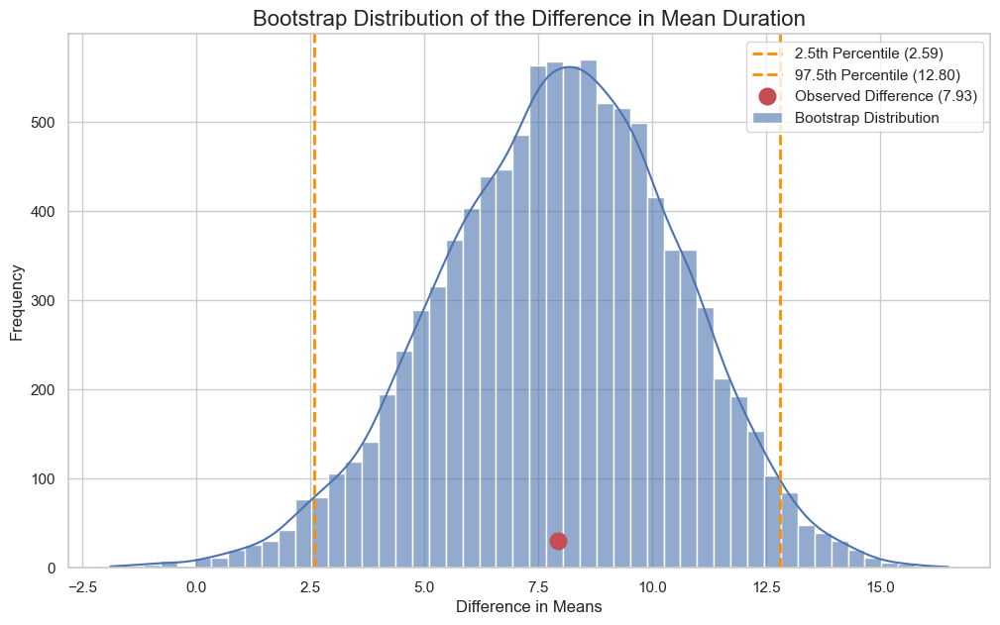

In [17]:
plotBootstrapDistribution(bootstrapped_diff_duration, obs_diff_duration, 'Duration')

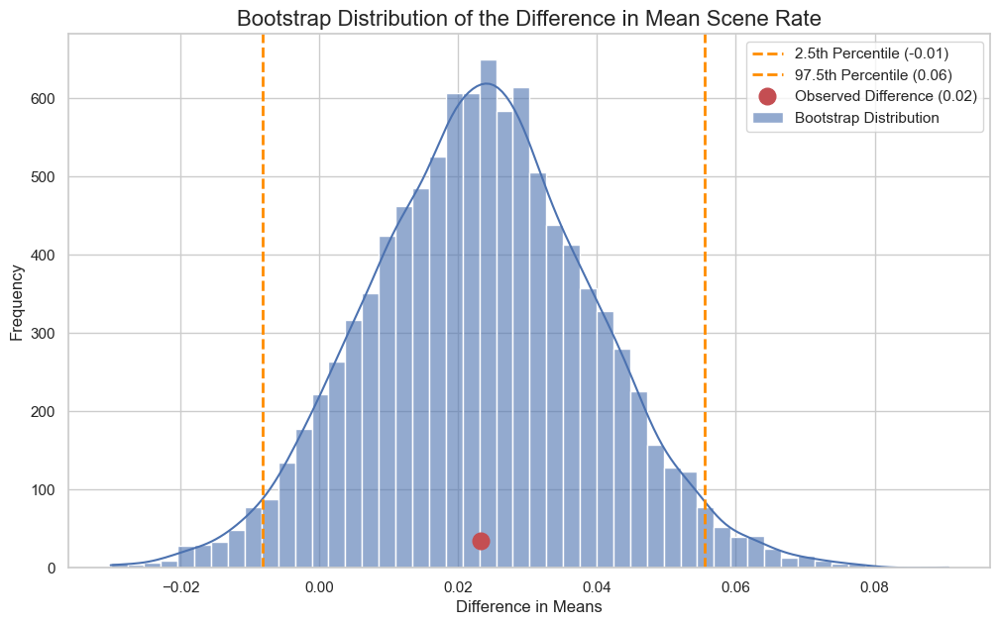

In [18]:
plotBootstrapDistribution(bootstrapped_diff_scene, obs_diff_scene, "Scene Rate")

### Analyzing the above results:
- As I intuitively expected, it would seem that there isn't a statistically significant difference between alt-right corecore edits and corecore edits generally. We thus fail to reject the null hypothesis
- So if they are structurally similar, they mimic similar genre conventions in my reading. We can therefore rely on something like semantic content (images, visual semiotic) as a means of distinguishing the two

# Section 1.5: Exploring the comments data
- I had some trouble scraping comments data, so I wanted to do only light exploration here for now
- Successfully scraped 1287/1492 posts, for 22135 comments
- However, for some reason, around 5000 of the comments I scraped cannot be matched to a relevant video... trying to figure this out currently
- Basically, based on the tags of the videos I pulled these comments from, how well do they seperate?
- Must also consider filtering (spam and non-english)..

In [14]:
import pandas as pd
import numpy as np
import torch
from transformers import AutoTokenizer, AutoModel
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
from typing import Tuple, Optional
import warnings
warnings.filterwarnings('ignore')

In [41]:
def embedTexts(texts, model_name='sentence-transformers/all-MiniLM-L6-v2', batch_size=32):
    """
    Embed texts using Hugging Face transformers 
    """
    # Ensure texts is a list of strings
    if isinstance(texts, str):
        texts = [texts]
    
    texts = [str(text) for text in texts]
    
    # Set device to MPS if available, otherwise CPU
    if torch.backends.mps.is_available():
        device = torch.device("mps")
        print("Using MPS (Apple Silicon GPU)")
    else:
        device = torch.device("cpu")
        print("MPS not available, using CPU")
    
    # Load tokenizer and model
    tokenizer = AutoTokenizer.from_pretrained(model_name)
    model = AutoModel.from_pretrained(model_name).to(device)
    model.eval()
    
    # Process in batches
    all_embeddings = []
    
    for i in range(0, len(texts), batch_size):
        batch_texts = texts[i:i + batch_size]
        
        # Tokenize batch
        encoded_input = tokenizer(
            batch_texts,
            padding=True,
            truncation=True,
            return_tensors='pt',
            max_length=512
        )
        
        # Move to device
        encoded_input = {key: val.to(device) for key, val in encoded_input.items()}
        
        # Generate embeddings
        with torch.no_grad():
            model_output = model(**encoded_input)
        
        # Mean pooling
        token_embeddings = model_output[0]
        attention_mask = encoded_input['attention_mask']
        
        input_mask_expanded = attention_mask.unsqueeze(-1).expand(token_embeddings.size()).float()
        
        embeddings = torch.sum(token_embeddings * input_mask_expanded, 1) / torch.clamp(
            input_mask_expanded.sum(1), min=1e-9
        )
        
        # Normalize embeddings
        embeddings = torch.nn.functional.normalize(embeddings, p=2, dim=1)
        
        # Move to CPU and store
        all_embeddings.append(embeddings.cpu().numpy())
        
        # Optional: Clear MPS cache between batches
        if device.type == 'mps':
            torch.mps.empty_cache()
    
    # Concatenate all batches
    embeddings_np = np.vstack(all_embeddings)

    del model
    del tokenizer
    if torch.cuda.is_available():
        torch.cuda.empty_cache()
    gc.collect()
    
    return embeddings_np


def reduceDimensionsPCA(embeddings, n_components = 2, normalize = True):
    """
    Reduce dimensionality of embeddings using PCA.
     2 for viz
    """    
    if normalize:
        scaler = StandardScaler()
        embeddings = scaler.fit_transform(embeddings)
    
    pca = PCA(n_components=n_components)
    reduced_embeddings = pca.fit_transform(embeddings)
    
    
    return reduced_embeddings, pca


def visualizeEmbeddings(embeddings_2d,
                         classes,
                         title = "Comments PCA Visualization",
                         figsize = (12, 8),
                         save_path = None):
    """
    Visualize 2D PCA embeddings colored by class labels.
    
    """
    
    # Create figure
    fig, ax = plt.subplots(figsize=figsize)
    
    # Get unique classes and assign colors
    unique_classes = np.unique(classes)
    colors = sns.color_palette("husl", len(unique_classes))
    class_to_color = dict(zip(unique_classes, colors))
    
    # Plot each class separately for legend
    for cls in unique_classes:
        mask = classes == cls
        ax.scatter(embeddings_2d[mask, 0], 
                  embeddings_2d[mask, 1],
                  c=[class_to_color[cls]],
                  label=str(cls),
                  alpha=0.7,
                  s=100,
                  edgecolors='white',
                  linewidth=1)
    
    # Formatting
    ax.set_xlabel('First Principal Component', fontsize=13, fontweight='bold')
    ax.set_ylabel('Second Principal Component', fontsize=13, fontweight='bold')
    ax.set_title(title, fontsize=16, fontweight='bold', pad=20)
    ax.legend(title='Class', fontsize=11, title_fontsize=12, 
             loc='best', framealpha=0.9, edgecolor='gray')
    ax.grid(True, alpha=0.3, linestyle='--')
    
    # Style improvements
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Figure saved to {save_path}")
    
    return fig

In [42]:
# visualizing comments
df = pd.read_csv("classified_output_comments.csv", index_col=False)

# ensure all are strings (some emojis)
df['text'] = df['text'].astype('str')

# handling unknown comments
df['class'] = df['class'].fillna('Unknown').astype(str).values

# drop any errors
df = df[df['text'].apply(lambda x: isinstance(x, str))]

texts = df["text"].tolist()
classes = df["class"].values

# Embed
embeddings = embedTexts(texts, model_name='sentence-transformers/all-MiniLM-L6-v2')

Using MPS (Apple Silicon GPU)


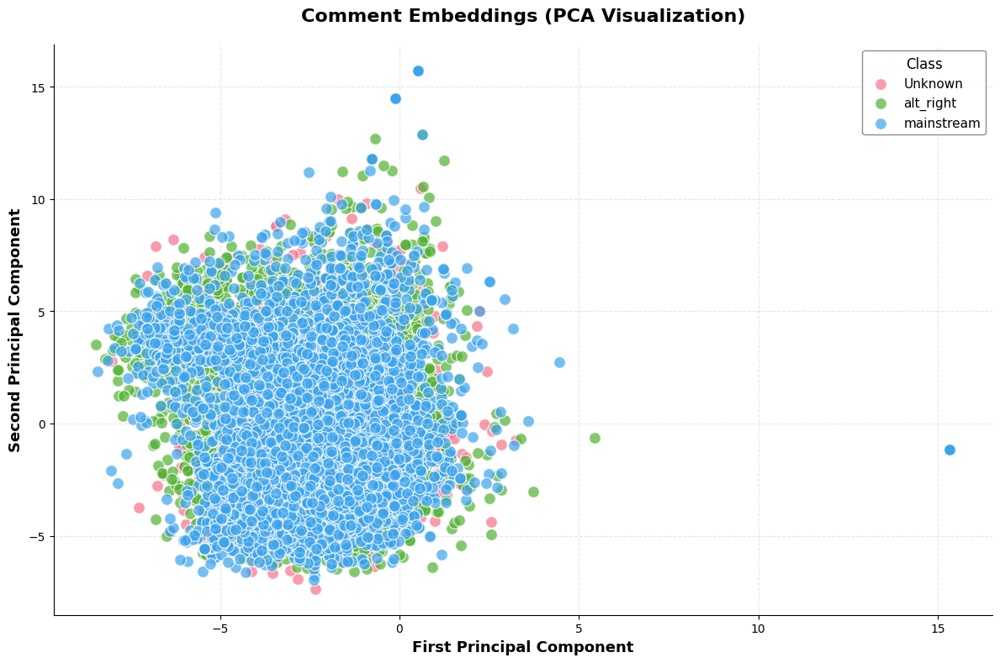

In [43]:
# PCA reduction
pca_embeddings, pca_model = reduceDimensionsPCA(
    embeddings, 
    n_components=2
)

# Visualize
fig = visualize_embeddings(
    pca_embeddings,
    classes,
    title="Comment Embeddings (PCA Visualization)",
    save_path=None
)

- This tells me that comments by themselves may not carry enough signal... let us hope in multimodality they become better

# Section 2: Baselines
### Primary Goals
- In this section, we aim to use the train sets to do the following:
  - Explore semantic differences in the videos, as scene in a UMAP projected 2d scatterplot of them
  - Train a baseline classifier (logistic regression) on the average embeddings of each video, use later on test set

## UMAP
- First, we use UMAP projection to observe how seperated the averaged CLIP embeddings of the videos are
- Then, we train a baseline classifier off of these averaged clip embeddings for the videos

In [20]:
import torch
from transformers import CLIPProcessor, CLIPModel
import umap
from tqdm import tqdm
import sys

In [21]:
def check_device():
    """
    Checks for the optimal computation device, prioritizing Apple's MPS.
    This is key for performance on your M3 Pro.
    """
    if torch.backends.mps.is_available():
        device = torch.device("mps")
        print("Using Apple MPS (M3 Pro/M-series) for acceleration.")
    elif torch.cuda.is_available():
        device = torch.device("cuda")
        print("Using NVIDIA CUDA for acceleration.")
    else:
        device = torch.device("cpu")
        print("Using CPU. (MPS or CUDA not available)")
    return device

def sampleFrames(video_path: str, sample_rate_hz: float = 1.0):
    """
    extracts frames from a video file at a specified sample rate.
    This sample rate is being used as a baseline threshold rn to ensure
    no video is comprised of more frames than the other
    """
    frames = []
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print(f"Error: Could not open video {video_path}", file=sys.stderr)
        return []

    fps = cap.get(cv2.CAP_PROP_FPS)
    if fps == 0 or fps is None:
        print(f"Warning: Video {video_path} has 0 FPS. Defaulting to 30.", file=sys.stderr)
        fps = 30.0 # Assign a default to avoid division by zero

    frame_interval = int(fps / sample_rate_hz)
    if frame_interval == 0:
        frame_interval = 1 # Ensure at least some frames are sampled

    frame_count = 0
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        
        # Sample the frame if it's at the correct interval
        if frame_count % frame_interval == 0:
            # Convert from OpenCV's BGR format to PIL's RGB format
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            pil_image = Image.fromarray(frame_rgb)
            frames.append(pil_image)
        
        frame_count += 1
        
    cap.release()
    return frames

def getVideoEmbedding(video_path, processor, model, device, 
                      sample_rate_hz = 1.0, batch_size = 64):
    """
    Generates a single, averaged embedding for an entire video.
    
    This function:
    1. Samples frames using `sample_frames`.
    2. Embeds all frames using CLIP in batches (for memory efficiency).
    3. Averages all frame embeddings into one vector.
    """
    try:
        frames = sampleFrames(video_path, sample_rate_hz)
        if not frames:
            print(f"Warning: No frames extracted from {video_path}", file=sys.stderr)
            return None
        
        all_embeddings = []
        
        # Process in batches to avoid OOM errors on very long videos
        for i in range(0, len(frames), batch_size):
            batch_frames = frames[i:i+batch_size]
            
            # The processor handles resizing, normalization, etc.
            inputs = processor(
                text=None, 
                images=batch_frames, 
                return_tensors="pt", 
                padding=True
            )
            
            # Move tensor inputs to the correct device (e.g., MPS)
            inputs = {k: v.to(device) for k, v in inputs.items()}
            
            # Run inference
            with torch.no_grad():
                image_features = model.get_image_features(**inputs)
            
            # Move results back to CPU for numpy
            all_embeddings.append(image_features.cpu().numpy())

        if not all_embeddings:
            return None

        # Concatenate all batch results and then average
        all_embeddings_np = np.concatenate(all_embeddings, axis=0)
        avg_embedding = np.mean(all_embeddings_np, axis=0)
        
        # Normalize the final embedding (good practice for UMAP)
        norm = np.linalg.norm(avg_embedding)
        if norm == 0:
            return avg_embedding
        return avg_embedding / norm

    except Exception as e:
        print(f"Error processing {video_path}: {e}", file=sys.stderr)
        return None

def getUmapEmbeddings(video_embeddings_list, n_neighbors: int = 5, min_dist: float = 0.3):
    """
    reduce CLIP embeddings to 2D using UMAP
    """
    print("Running UMAP dimensionality reduction...")
    if not video_embeddings_list:
        raise ValueError("Embedding list is empty, cannot run UMAP.")
        
    embedding_matrix = np.array(video_embeddings_list)
    
    reducer = umap.UMAP(
        n_components=2,
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        random_state=42, # For reproducible results
        metric='cosine' # Cosine distance is often good for normalized embeddings
    )
    
    umap_embeddings = reducer.fit_transform(embedding_matrix)
    return umap_embeddings

def plotScatterplot(umap_embeddings, labels, set_a_name, set_b_name, filenames):
    """
      create UMAP scatterplot
    """
    print("Generating scatterplot...")
    plt.figure(figsize=(14, 10))
    
    # Find the indices for each set
    indices_a = np.where(labels == 0)[0]
    indices_b = np.where(labels == 1)[0]
    
    # Plot Set A
    plt.scatter(
        umap_embeddings[indices_a, 0], 
        umap_embeddings[indices_a, 1], 
        c='blue', 
        label=set_a_name, 
        alpha=0.7
    )
    
    # Plot Set B
    plt.scatter(
        umap_embeddings[indices_b, 0], 
        umap_embeddings[indices_b, 1], 
        c='red', 
        label=set_b_name, 
        alpha=0.7
    )
    
    # Add annotations for a few points to make the plot interpretable
    # Annotate up to 5 points from each set
    for i in indices_a[:5]:
        filename = os.path.basename(filenames[i])
        plt.annotate(filename, (umap_embeddings[i, 0], umap_embeddings[i, 1]), fontsize=8)
        
    for i in indices_b[:5]:
        filename = os.path.basename(filenames[i])
        plt.annotate(filename, (umap_embeddings[i, 0], umap_embeddings[i, 1]), fontsize=8)

    plt.title('UMAP Projection of Video Embeddings', fontsize=16)
    plt.xlabel('UMAP Component 1', fontsize=12)
    plt.ylabel('UMAP Component 2', fontsize=12)
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.5)
    
    output_filename = "video_umap_scatterplot.png"
    try:
        plt.savefig(output_filename)
        print(f"Scatterplot saved to {output_filename}")
        plt.show() # Also display the plot
    except Exception as e:
        print(f"Error saving plot: {e}", file=sys.stderr)

In [22]:
# setup model and device
device = None
if torch.backends.mps.is_available():
    device = torch.device("mps")
    print("Using Apple MPS (M3 Pro/M-series) for acceleration.")
model_name = "openai/clip-vit-base-patch32"
model = CLIPModel.from_pretrained(model_name).to(device)
processor = CLIPProcessor.from_pretrained(model_name)

Using Apple MPS (M3 Pro/M-series) for acceleration.


In [23]:
# process all videos and build lists
all_embeddings = []
labels = []
filenames = []

print("Handling Alt Videos")
for vid in tqdm(train_alt_vids, desc="Alt Right"):
    emb = getVideoEmbedding(vid, processor, model, device, 1.0)
    if emb is not None:
        all_embeddings.append(emb)
        labels.append(1) # 1 for belonging to alt-right
        filenames.append(vid)

print("\n Handling Normal Videos")
for vid in tqdm(train_norm_vids, desc="Normal Corecore"):
    emb = getVideoEmbedding(vid, processor, model, device, 1.0)
    if emb is not None:
        all_embeddings.append(emb)
        labels.append(0) # 0 for belonging to normal corecore
        filenames.append(vid)

Handling Alt Videos


Alt Right: 100%|██████████████████████████████| 706/706 [09:00<00:00,  1.31it/s]



 Handling Normal Videos


Normal Corecore: 100%|████████████████████████| 434/434 [06:32<00:00,  1.11it/s]


/Users/carl_illustrisimo/opt/anaconda3/envs/info206a/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Running UMAP dimensionality reduction...
Generating scatterplot...
Scatterplot saved to video_umap_scatterplot.png


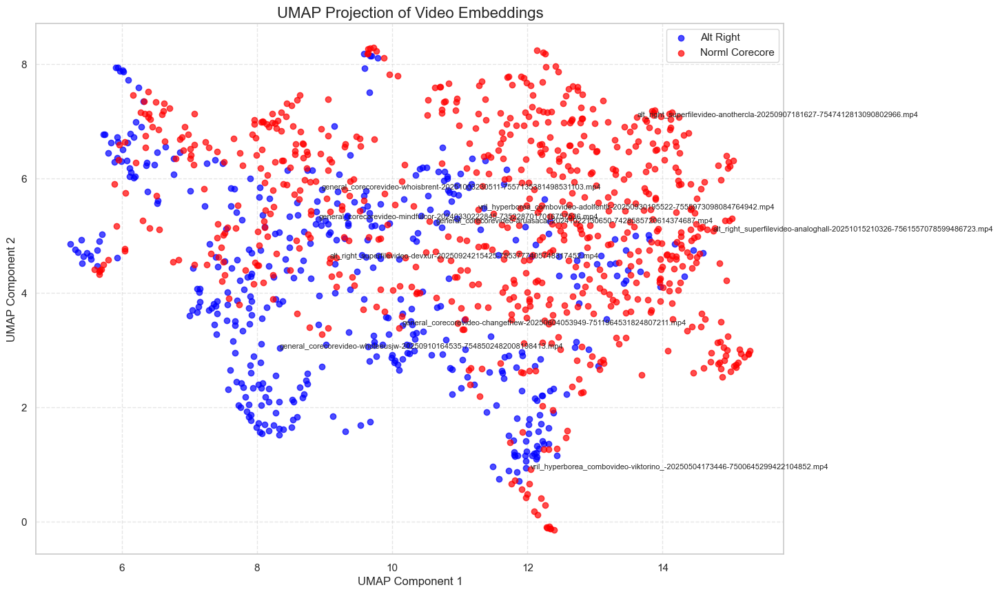


Analysis Complete.


In [24]:
# Convert lists to numpy arrays for UMAP and plotting
labels_np = np.array(labels)
filenames_np = np.array(filenames)

# run UMAP

# Adjust n_neighbors if there are very few videos
n_videos = len(all_embeddings)
n_neighbors = min(15, n_videos - 1) 
    
umap_results = getUmapEmbeddings(all_embeddings, n_neighbors=n_neighbors)

# Plot
plotScatterplot(
    umap_results, 
    labels_np, 
    "Alt Right", 
    "Norml Corecore",
    filenames_np
)
print("\nAnalysis Complete.")

**Given the overlap above, I do not expect the classifier with CLIP embeddings to work great**

### Baseline Classifiers
- First one is logistic regression using duration and scene rate
- Second is Logistic regression with CLIP wmbeddings
- Third is a mean classifier

In [25]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

In [26]:
# prepping data for first baseline

# norm df
train_norm_df = pd.DataFrame(train_norm_durations, columns=['vid','duration'])
train_norm_df['class'] = 0 # 0 for normal
train_norm_df['scene_rate'] = [item[1] for item in train_norm_scene_rate]

# alt df
train_alt_df = pd.DataFrame(train_alt_durations, columns=['vid', 'duration'])
train_alt_df['class'] = 1 # 1 for alt
train_alt_df['scene_rate'] = [item[1] for item in train_alt_scene]

In [27]:
# concat two 
train_df = pd.concat([train_norm_df, train_alt_df], axis=0)

In [28]:
# check
train_df.head()

,vid,duration,class,scene_rate
0,videos/normal2/general_corecorevideo-changethe...,61.100000,0,0.065466
1,videos/normal2/general_corecorevideo-aruasacai...,67.466667,0,0.533597
2,videos/normal2/general_corecorevideo-wholeeusj...,60.333333,0,0.082873
3,videos/normal2/general_corecorevideo-mindfulco...,63.100000,0,0.142631
4,videos/normal2/general_corecorevideo-whoisbren...,62.033333,0,0.000000


In [29]:
# train first classifier
# feature and target column names
feature_cols = ['duration', 'scene_rate']
target_col = 'class'

X = train_df[feature_cols]
y = train_df[target_col]

# create a processing pipeline
basic_model = Pipeline([
    ('scaler', StandardScaler()),
    ('log_reg', LogisticRegression(random_state=42))
])

# train the pipeline on the data
basic_model.fit(X, y)

basic_model.score(X, y) # (slightly better than half, but on TRAIN features. Will try test features later)

0.612280701754386

In [30]:
# Making a CLIP based logistic regression baseline model
X_clip = np.array(all_embeddings)
y_clip = labels_np

# recall that transformer embeddings are already normalized (thats why distance is q*k)
basic_CLIP_model = LogisticRegression(random_state = 42)

basic_CLIP_model.fit(X_clip, y_clip)
basic_CLIP_model.score(X_clip, y_clip)

0.8921052631578947

# Section 3: Videos and frames
### Primary Goal:
- **For the task of downstream video clustering to identify alt right symbolism/imagery**
  - Break our data into frames
  - Use those frames to create clip embedding representations of videos
  - Get representative frames for videos via k-means clustering of each video (use those for our video clustering pipeline)
  - Experiment with clustering techniques

## Saving Frames via K-Means clustering
- For this case, I use k=5 as a baseline (some videos are very short)
- I want to try a case where I iterate through 5-20 as possible values for k, saving the k amount of frames based on that clusters silhouette score. Due to compute, I leave this case for later
- I've had to try many different optimizations, i've keyed them as different functions, but leave them here for your viewing
- I settled upon: reducing image size, pca, MPS-->for my clustering framing task

In [13]:
import os
import gc
import glob
from pathlib import Path
from typing import List, Tuple, Optional
import cv2
import numpy as np
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.decomposition import PCA
import time
import tqdm

# Optional: PyTorch for MPS acceleration
try:
    import torch
    from torch import nn
    TORCH_AVAILABLE = True
except ImportError:
    TORCH_AVAILABLE = False
    print("PyTorch not available. Install with: pip install torch")

In [14]:
def getVideoFilepaths(directories, extensions = None):
    """
    Recursively glob directories to get all video file paths.
    """
    if extensions is None:
        extensions = ['*.mp4', '*.avi', '*.mov', '*.mkv', '*.flv', '*.wmv', '*.m4v']
    
    video_files = []
    for directory in directories:
        for ext in extensions:
            pattern = os.path.join(directory, '**', ext)
            video_files.extend(glob.glob(pattern, recursive=True))
    
    return sorted(video_files)


def extractFramesFromVideo(video_path, max_frames = None, sample_rate = 1, resize_to = (128, 128)):
    """
    Extract frames from a video file with optional resizing for speed.
    """
    cap = cv2.VideoCapture(video_path)
    
    if not cap.isOpened():
        print(f"Error: Could not open video {video_path}")
        return [], False
    
    frames = []
    frame_count = 0
    extracted_count = 0
    
    while True:
        ret, frame = cap.read()
        
        if not ret:
            break
        
        if frame_count % sample_rate == 0:
            # Resize frame if specified (MAJOR SPEEDUP)
            if resize_to is not None:
                frame = cv2.resize(frame, resize_to, interpolation=cv2.INTER_AREA)
            
            frames.append(frame)
            extracted_count += 1
            
            if max_frames and extracted_count >= max_frames:
                break
        
        frame_count += 1
    
    cap.release()
    
    return frames, True


def clusterFramesKmeans(frames, k = 5, method = 'minibatch', use_pca = True, pca_components = 50):
    """
    K-means clustering, can cycle through diff clustering strategies
    """
    if len(frames) == 0:
        return np.array([]), []
    
    if len(frames) < k:
        print(f"Warning: Number of frames ({len(frames)}) < k ({k}). Using {len(frames)} clusters.")
        k = len(frames)
    
    start_time = time.time()
    
    # Flatten frames
    frame_shape = frames[0].shape
    flattened_frames = np.array([frame.flatten() for frame in frames])
    flattened_frames = flattened_frames.astype(np.float32) / 255.0
    
    # PCA dimensionality reduction   to speed up
    if use_pca and flattened_frames.shape[1] > pca_components:
        pca = PCA(n_components=pca_components, random_state=42)
        flattened_frames = pca.fit_transform(flattened_frames)
    
    # Choose clustering method
    if method == 'pytorch_mps' and TORCH_AVAILABLE:
        representative_indices, labels = _cluster_pytorch_mps(flattened_frames, k)
    elif method == 'minibatch':
        representative_indices, labels = _cluster_minibatch(flattened_frames, k)
    elif method == 'mps_minibatch':
        representative_indices, labels = _cluster_pytorch_mps_minibatch(flattened_frames, k)
    else:  # standard
        representative_indices, labels = _cluster_standard(flattened_frames, k)
    
    elapsed = time.time() - start_time
    
    return representative_indices, labels


def _cluster_standard(data, k):
    """Standard k-means clustering."""
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    labels = kmeans.fit_predict(data)
    
    cluster_representatives = []
    for cluster_id in range(k):
        cluster_indices = np.where(labels == cluster_id)[0]
        if len(cluster_indices) == 0:
            continue
        centroid = kmeans.cluster_centers_[cluster_id]
        distances = np.linalg.norm(data[cluster_indices] - centroid, axis=1)
        closest_idx = cluster_indices[np.argmin(distances)]
        cluster_representatives.append(closest_idx)
    
    return np.array(cluster_representatives), labels.tolist()


def _cluster_minibatch(data, k):
    """MiniBatch k-means clustering"""
    kmeans = MiniBatchKMeans(n_clusters=k, random_state=42, batch_size=256, n_init=3)
    labels = kmeans.fit_predict(data)
    
    cluster_representatives = []
    centers = kmeans.cluster_centers_.copy()  # Make a copy to release kmeans sooner
    
    for cluster_id in range(k):
        cluster_indices = np.where(labels == cluster_id)[0]
        if len(cluster_indices) == 0:
            continue
            
        # Use view instead of creating new array
        cluster_data = data[cluster_indices]
        centroid = centers[cluster_id]
        distances = np.linalg.norm(cluster_data - centroid, axis=1)
        closest_idx = cluster_indices[np.argmin(distances)]
        cluster_representatives.append(int(closest_idx))  # Convert to Python int immediately
        
        # Explicitly delete to free memory
        del cluster_indices, cluster_data, distances
    
    # Convert labels to list BEFORE deleting numpy array
    labels_list = [int(x) for x in labels]  # Convert to Python ints
    
    # Delete large objects explicitly
    del kmeans, labels, centers
    gc.collect()
    
    return np.array(cluster_representatives), labels_list


def _cluster_pytorch_mps(data, k, max_iter = 100):
    """
    PyTorch k-means with MPS (Metal Performance Shaders) acceleration 
    """
    if not TORCH_AVAILABLE:
        print("PyTorch not available, falling back to minibatch")
        return _cluster_minibatch(data, k)
    
    # Check MPS availability
    if not torch.backends.mps.is_available():
        print("MPS not available, using CPU")
        device = torch.device('cpu')
    else:
        device = torch.device('mps')
    
    # Convert to PyTorch tensor
    X = torch.from_numpy(data).float().to(device)
    n_samples = X.shape[0]
    
    # Initialize centroids using k-means++
    centroids = _kmeans_plusplus_init_torch(X, k)
    
    # K-means iterations
    for iteration in range(max_iter):
        # Assign clusters
        distances = torch.cdist(X, centroids)
        labels = torch.argmin(distances, dim=1)
        
        # Update centroids
        new_centroids = torch.zeros_like(centroids)
        for i in range(k):
            mask = labels == i
            if mask.sum() > 0:
                new_centroids[i] = X[mask].mean(dim=0)
            else:
                new_centroids[i] = centroids[i]
        
        # Check convergence
        if torch.allclose(centroids, new_centroids, atol=1e-4):
            break
        
        centroids = new_centroids
    
    # Find representative frames (closest to centroids)
    cluster_representatives = []
    labels_cpu = labels.cpu().numpy()
    
    for cluster_id in range(k):
        cluster_indices = np.where(labels_cpu == cluster_id)[0]
        if len(cluster_indices) == 0:
            continue
        
        cluster_mask = labels == cluster_id
        cluster_points = X[cluster_mask]
        centroid = centroids[cluster_id]
        
        distances = torch.norm(cluster_points - centroid, dim=1)
        local_min_idx = torch.argmin(distances).item()
        
        # Map back to global index
        global_idx = cluster_indices[local_min_idx]
        cluster_representatives.append(global_idx)
    
    return np.array(cluster_representatives), labels_cpu.tolist()

def _cluster_pytorch_mps_minibatch(data, k, batch_size = 256, max_iter = 100):
    """
    MiniBatch K-means with MPS acceleration - BEST OF BOTH WORLDS!
    """
    if not TORCH_AVAILABLE:
        return _cluster_minibatch(data, k)
    
    device = torch.device('mps' if torch.backends.mps.is_available() else 'cpu')
    print(f"Using MiniBatch K-Means on {device}")
    
    X = torch.from_numpy(data).float().to(device)
    n_samples = X.shape[0]
    
    # Initialize centroids
    centroids = _kmeans_plusplus_init_torch(X, k)
    
    # MiniBatch iterations
    indices = torch.randperm(n_samples, device=device)
    
    for iteration in range(max_iter):
        # Process in mini-batches
        for batch_start in range(0, n_samples, batch_size):
            batch_end = min(batch_start + batch_size, n_samples)
            batch_indices = indices[batch_start:batch_end]
            batch = X[batch_indices]
            
            # Assign to nearest centroid
            distances = torch.cdist(batch, centroids)
            labels = torch.argmin(distances, dim=1)
            
            # Update centroids incrementally (MiniBatch style)
            for i in range(k):
                mask = labels == i
                if mask.sum() > 0:
                    # Exponential moving average update
                    learning_rate = 1.0 / (iteration + 1)
                    centroids[i] = (1 - learning_rate) * centroids[i] + \
                                   learning_rate * batch[mask].mean(dim=0)
        
        # Shuffle for next iteration
        indices = torch.randperm(n_samples, device=device)
    
    # Final assignment
    distances = torch.cdist(X, centroids)
    labels = torch.argmin(distances, dim=1)
    
    # Find representatives
    cluster_representatives = []
    labels_cpu = labels.cpu().numpy()
    
    for cluster_id in range(k):
        cluster_indices = np.where(labels_cpu == cluster_id)[0]
        if len(cluster_indices) == 0:
            continue
        
        cluster_mask = labels == cluster_id
        cluster_points = X[cluster_mask]
        centroid = centroids[cluster_id]
        
        distances = torch.norm(cluster_points - centroid, dim=1)
        local_min_idx = torch.argmin(distances).item()
        global_idx = cluster_indices[local_min_idx]
        cluster_representatives.append(global_idx)
    
    return np.array(cluster_representatives), labels_cpu.tolist()

def _kmeans_plusplus_init_torch(X: torch.Tensor, k: int) -> torch.Tensor:
    """K-means++ initialization in PyTorch."""
    n_samples = X.shape[0]
    centroids = []
    
    # Choose first centroid randomly
    first_idx = torch.randint(0, n_samples, (1,)).item()
    centroids.append(X[first_idx])
    
    # Choose remaining centroids
    for _ in range(1, k):
        centroids_tensor = torch.stack(centroids)
        distances = torch.cdist(X, centroids_tensor).min(dim=1)[0]
        probs = distances / distances.sum()
        next_idx = torch.multinomial(probs, 1).item()
        centroids.append(X[next_idx])
    
    return torch.stack(centroids)


def saveRepresentativeFrames(frames, representative_indices, video_path, output_dir = 'representative_frames', original_frames = None):
    """
    Save representative frames with traceable naming.
    
    REMINDERS for slf
        frames: List of (possibly resized) frames used for clustering
        representative_indices: Indices of frames to save
        video_path: Original video file path
        output_dir: Directory to save representative frames
        original_frames: Optional list of original resolution frames to save instead
    """
    os.makedirs(output_dir, exist_ok=True)
    
    video_name = Path(video_path).stem
    video_parent = Path(video_path).parent.name
    
    saved_paths = []
    frames_to_save = original_frames if original_frames is not None else frames
    
    for i, frame_idx in enumerate(representative_indices):
        if frame_idx >= len(frames_to_save):
            print(f"Warning: Frame index {frame_idx} out of range")
            continue
        
        output_filename = f"{video_parent}_{video_name}_cluster{i:02d}_frame{frame_idx:05d}.jpg"
        output_path = os.path.join(output_dir, output_filename)
        
        cv2.imwrite(output_path, frames_to_save[frame_idx])
        saved_paths.append(output_path)
    
    return saved_paths


def processVideo(video_path, k = 5, output_dir = 'representative_frames', max_frames = None, sample_rate = 1, 
                        clustering_method = 'minibatch',
                           resize_for_clustering = (224, 224),
                           use_pca = True,
                           pca_components = 50,
                           save_original_resolution = True):
    """
    Process video pipelining function.
    
    REMINDERS
        video_path: Path to video file
        k: Number of clusters
        output_dir: Directory to save output frames
        max_frames: Maximum frames to extract (None = all)
        sample_rate: Frame sampling rate
        clustering_method: 'standard', 'minibatch', or 'pytorch_mps'
        resize_for_clustering: Resize frames to this size for clustering (smaller = faster!)
        use_pca: Use PCA dimensionality reduction (recommended)
        pca_components: Number of PCA components (50-100 is good)
        save_original_resolution: If True, saves original resolution frames (slower extraction)
    
    Returns:
        List of saved representative frame paths
    """
    
    # Extract frames for clustering (resized)
    frames, success = extractFramesFromVideo(
        video_path, max_frames, sample_rate, resize_to=resize_for_clustering
    )
    
    if not success or len(frames) == 0:
        print(f"Failed to extract frames from {video_path}")
        return []
    
    # Optionally extract original resolution frames for saving
    original_frames = None
    if save_original_resolution:
        original_frames, _ = extractFramesFromVideo(
            video_path, max_frames, sample_rate, resize_to=None
        )
    
    # Cluster frames
    representative_indices, labels = clusterFramesKmeans(
        frames, k, method=clustering_method, use_pca=use_pca, pca_components=pca_components
    )
    
    # Save representative frames
    saved_paths = saveRepresentativeFrames(
        frames, representative_indices, video_path, output_dir, original_frames
    )
    
    
    return saved_paths


def processDirectories(directories, k = 5, output_dir = 'representative_frames', max_frames = None, sample_rate = 1,
                                 clustering_method = 'minibatch',
                                 resize_for_clustering = (224, 224),
                                 use_pca = True):
    """
    Process all videos with optimized settings.
    """
    video_files = getVideoFilepaths(directories)
    print(f"Found {len(video_files)} video files")
    print(f"Optimization settings: method={clustering_method}, resize={resize_for_clustering}, PCA={use_pca}\n")
    
    results = {}
    total_start = time.time()

    # added tqdm for loading
    for i, video_path in tqdm.tqdm(enumerate(video_files[0:10], 1), total=len(video_files[0:10]), desc="Processing videos", unit="video"):
        try:
            saved_paths = processVideo(
                video_path, k, output_dir, max_frames, sample_rate,
                clustering_method, resize_for_clustering, use_pca
            )
            results[video_path] = saved_paths
        except Exception as e:
            tqdm.tqdm.write(f"Error processing {video_path}: {str(e)}")  # Use tqdm.write instead of print
            results[video_path] = []

        # Force garbage collection, every 10 videos 
        if i % 10 == 0:  
            gc.collect()
    
    total_time = time.time() - total_start
    print(f"ALL VIDEOS PROCESSED in {total_time:.2f} seconds ({total_time/60:.1f} minutes)")
    
    return results

In [15]:
# Processing first alt videos
directories_to_process = [
    "videos/alt_right_2",
]

# using MiniBatch K-Means with small resize and PCA to optimize
results = processDirectories(
    directories=directories_to_process,
    k=5,
    output_dir='videos/representative_frames/altTEMP',
    sample_rate=1,              
    clustering_method='minibatch',  
    resize_for_clustering=(128, 128), 
    use_pca=True                 
)

# MPS-accelerated (M1/M2/M3 Macs) alt
# norm_results = processDirectories(
#     directories=directories_to_process,
#     k=5,
#     clustering_method='pytorch_mps',  # Use Metal acceleration
#     resize_for_clustering=(224, 224),
#     use_pca=True
# )

Found 942 video files
Optimization settings: method=minibatch, resize=(128, 128), PCA=True



Processing videos: 100%|█████████████████████| 10/10 [01:16<00:00,  7.65s/video]

ALL VIDEOS PROCESSED in 76.48 seconds (1.3 minutes)


# THE ABOVE (KERNEL RESTART) AT 642, I REWROTE FOR GC AND OPTIMIZATION, DID GO THROUGH 642 VIDEOS
- NOTE TO SELF: changing to first 10 to show that it works ([0:10])

## WORK IN PROGRESS: Baseline Concept Clustering
- I aim to experiment with different methods later, for now, we see performance of Concept on my frame extraction method above...
- I became frustrated it was crashing here again after my initial run for the presentation didn't, but I am remiss I cannot figure it out currently
- **To fix**: I am thinking of essentially defining my own pipeline and optimizing the code for the task. Then reading it in as a py file

In [3]:
import glob
import os
import torch
from concept import ConceptModel
import random
import nltk
nltk.download("wordnet")
from nltk.corpus import wordnet as wn

[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/carl_illustrisimo/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [4]:
def analyzeFrames(frames_dir='videos/representative_frames/alt'):
   # create a search pattern to find all .jpg files in the directory
    search_pattern = os.path.join(frames_dir, '*.jpg')
    frame_paths = sorted(glob.glob(search_pattern)) # use sorted glob for ordered processing

    # check if frames located
    print(f"Found {len(frame_paths)} frames")

    try:
    
        # print(frame_paths)
        
        # initialize and use the Concept Model
        concept_model = ConceptModel()
    
        # load WordNet to get human-readable labels for the concepts
        all_nouns = [word for synset in wn.all_synsets('n') for word in synset.lemma_names()]
        selected_nouns = random.sample(all_nouns, 50_000)
    
        # find concepts in the loaded images
        concepts = concept_model.fit_transform(frame_paths, docs=selected_nouns)
    
        # visualize the Results 
        # generates a plot showing the top concepts found across all images
        print("Visualizing Concepts")
        concept_model.visualize_concepts(top_n=9)
    
    finally:
        # finally ensures cleanup happens even if an error occurs
        if 'concept_model' in locals():
            # Move model to CPU first
            if hasattr(concept_model, 'model') and hasattr(concept_model.model, 'cpu'):
                concept_model.model.cpu()
            
            del concept_model
        
        if 'selected_nouns' in locals():
            del selected_nouns
        
        # clear GPU cache
        if torch.backends.mps.is_available():
            torch.mps.empty_cache()
        
        # Force garbage collection
        gc.collect()

In [ ]:
concepts, concept_model = analyzeFrames()

Found 3025 frames


100%|███████████████████████████████████████████| 24/24 [00:41<00:00,  1.73s/it]
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


# WORK IN PROGRESS: Video Captioning Small test
- STILL NEED TO test out whisper, with the same goal as my comments initial test: **do captions from alt_right and mainstream videos cluster differently?**
- ONLY DOING FIRST 10 TO TEST CODE

In [8]:
from faster_whisper import WhisperModel
from pathlib import Path
from multiprocessing import Pool
import json
import glob
import tqdm
import os

In [9]:
def transcribeVideo(video_path):
    model = WhisperModel("small", device="cpu", compute_type="int8")
    segments, info = model.transcribe(str(video_path))
    
    text = " ".join([seg.text for seg in segments])
    return {
        "file": video_path.name,
        "text": text
    }

In [12]:
# whisper transcription!
videos = list(Path("videos/alt_right_2").glob("*.mp4"))
results = []
for video in tqdm.tqdm(videos[0:10]):
    temp = transcribeVideo(video)
    results.append(temp)

# Save results
with open("captions.json", "w") as f:
    json.dump(results, f, indent=2)

100%|███████████████████████████████████████████| 10/10 [00:54<00:00,  5.41s/it]


In [19]:
import os
print(os.getcwd())

/Users/carl_illustrisimo/berkeley/Fall 25/Cultural Analytics/final_proj


# WORK IN PROGRESS: Librosa and Sonic Qualities
- I still need to work out the logic for this portion

# WORK IN PROGRESS: Multimodal Embeddding Clustering
- Still need to properly attend to transcription